# Lesson: 4_Segmentation_Parcellation

## Objectives


In [1]:
import os
import numpy as np
import pandas as pd
from nilearn import plotting
import matplotlib.pyplot as plt
import seaborn as sns

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/datasets/__init__.py:87: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  warn("Fetchers from the nilearn.datasets module will be "


In [2]:
%matplotlib inline

In [97]:
nilearn_cache_dir = "../local_data/nilearn_cache"

# Get MRI data

In [3]:
!ls

1_sMRI_modalities.ipynb			  6b_sMRI_StasticalAnalysis.ipynb
2_sMRI_image_cleanup.ipynb		  6_sMRI_StatisticalAnalysis.ipynb
3_sMRI_spatial_norm.ipynb		  7_sMRI_reproducibility.ipynb
4_sMRI_segmentation_quantification.ipynb  Stats2.ipynb


In [4]:
!tree ../local_data/AOMIC

../local_data/AOMIC
├── CHANGES
├── dataset_description.json
├── derivatives
│   ├── fmriprep
│   │   ├── dataset_description.json
│   │   └── sub-0001
│   │       └── anat
│   │           ├── sub-0001_desc-aparcaseg_dseg.nii.gz
│   │           ├── sub-0001_desc-aseg_dseg.nii.gz
│   │           ├── sub-0001_desc-brain_mask.json
│   │           ├── sub-0001_desc-brain_mask.nii.gz
│   │           ├── sub-0001_desc-preproc_T1w.json
│   │           ├── sub-0001_desc-preproc_T1w.nii.gz
│   │           ├── sub-0001_dseg.nii.gz
│   │           ├── sub-0001_from-MNI152NLin2009cAsym_to-T1w_mode-image_xfm.h5
│   │           ├── sub-0001_from-orig_to-T1w_mode-image_xfm.txt
│   │           ├── sub-0001_from-T1w_to-fsnative_mode-image_xfm.txt
│   │           ├── sub-0001_from-T1w_to-MNI152NLin2009cAsym_mode-image_xfm.h5
│   │           ├── sub-0001_hemi-L_inflated.surf.gii
│   │           ├── sub-0001_hemi-L_midthickness.surf.gii
│   │           ├── sub-0001_hemi-L_pial.surf.gii
│   │           ├──

## Read BIDS data with `pybids` package

In [5]:
from bids import BIDSLayout

In [6]:
data_dir = '../local_data/AOMIC'
bids_layout = BIDSLayout(data_dir, derivatives=True)
bids_layout

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/bids/layout/models.py:148: FutureWarning: The 'extension' entity currently excludes the leading dot ('.'). As of version 0.14.0, it will include the leading dot. To suppress this warning and include the leading dot, use `bids.config.set_option('extension_initial_dot', True)`.
  warnings.warn("The 'extension' entity currently excludes the leading dot ('.'). "


BIDS Layout: ...SDC-BIDS-sMRI/local_data/AOMIC | Subjects: 2 | Sessions: 0 | Runs: 0

In [7]:
sub1_anat_files = bids_layout.get(subject="0001", scope="derivatives", datatype='anat')
sub1_anat_files

[<BIDSImageFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_desc-aparcaseg_dseg.nii.gz'>,
 <BIDSImageFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_desc-aseg_dseg.nii.gz'>,
 <BIDSJSONFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_desc-brain_mask.json'>,
 <BIDSImageFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_desc-brain_mask.nii.gz'>,
 <BIDSJSONFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_desc-preproc_T1w.json'>,
 <BIDSImageFile filename='/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmri

In [8]:
t1_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', desc='preproc',
                            extension='nii.gz', return_type='filename')[0]
t1_mask_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', suffix='mask',
                               desc='brain', extension='nii.gz', return_type='filename')[0]
t1_seg_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', suffix='dseg',
                           extension='nii.gz', return_type='filename')[2]

In [9]:
#bids_layout.get(subject="1", scope="derivatives", datatype='anat', suffix='dseg',
#                extension='nii.gz', return_type='filename')

## Assign data to python objects with `nibabel` 

In [10]:
import nibabel as nib

### Assign T1 data

In [11]:
t1 = nib.load(t1_file)
t1_data = t1.get_fdata()
t1_affine = t1.affine

### Assign binary brain mask data

In [12]:
t1_mask = nib.load(t1_mask_file)
t1_mask_data = t1_mask.get_fdata()

### Apply brain mask on T1 data to get only brain data

In [13]:
t1_brain_data = np.where(t1_mask_data.astype('bool'), t1_data, 0)

### Assign segmentation data

In [14]:
t1_seg = nib.load(t1_seg_file)
t1_seg_data = np.squeeze(t1_seg.get_fdata())

In [15]:
nib.load?

# Tissue and region segmentation

## Segmenting images into tissue classes in normal and pathological tissues, and visualizing the segmentation

### Normal controls

#### Visualize volumetric data and intensity histogram

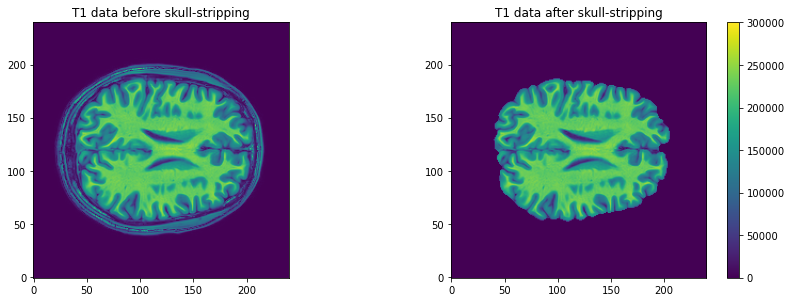

In [16]:
plt.figure(figsize=(12, 8))
n_plots = 2
n_cols = 2
# Plot first figure
plt.subplot(n_plots, n_cols, 1)
plt.imshow(t1_data[:, :, 110], vmax=300000, origin="lower")
plt.title('T1 data before skull-stripping')
# Plot first figure
plt.subplot(n_plots, n_cols, 2)
plt.imshow(t1_brain_data[:, :, 110], vmax=300000, origin="lower")
plt.title('T1 data after skull-stripping')
plt.colorbar();
plt.tight_layout() # Magic command to clean the overall plot

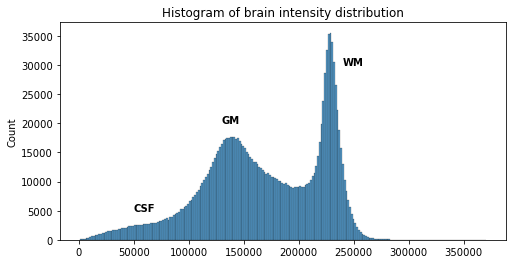

In [17]:
plt.figure(figsize=(8, 4))
# Compute the optimal bin size according to the data
bins = np.histogram_bin_edges(t1_brain_data[t1_brain_data != 0], bins='auto')
# Plot the histogram
sns.histplot(t1_brain_data[t1_brain_data != 0], bins=bins)
plt.title('Histogram of brain intensity distribution')
plt.text(50000, 5000, "CSF", size='medium', weight='bold')
plt.text(130000, 20000, "GM", size='medium', weight='bold')
plt.text(240000, 30000, "WM", size='medium', weight='bold');

#### Visualize individual tissue classes and associated histograms

In [18]:
from nilearn import plotting

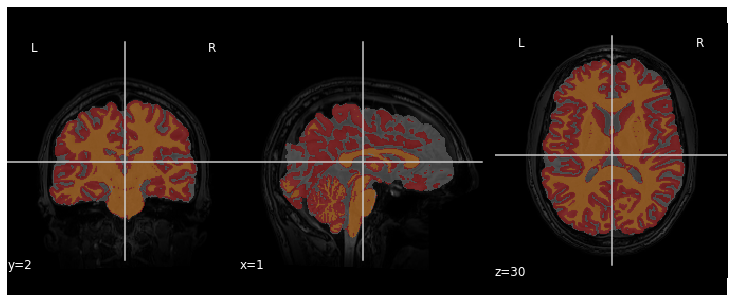

In [19]:
fig = plt.figure(figsize=(10, 4))
plotting.plot_roi(roi_img=t1_seg, bg_img=t1, alpha=0.4, figure=fig, cmap="Set1");

In [20]:
#plotting.view_img(stat_map_img=t1_seg, bg_img=t1, cmap="Set1", symmetric_cmap=False, opacity=0.4)

In [21]:
sns.histplot?

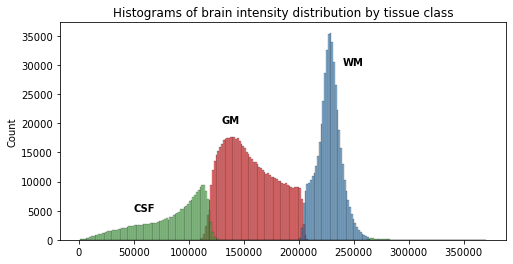

In [22]:
import itertools
labels = np.unique(t1_seg_data[t1_seg_data != 0]).astype('int')
plt.figure(figsize=(8, 4))
palette = itertools.cycle(sns.color_palette("Set1"))
for label in labels:
    sns.histplot(t1_brain_data[t1_seg_data == label], bins=bins, color=next(palette), alpha=0.6)
plt.title('Histograms of brain intensity distribution by tissue class')
plt.text(50000, 5000, "CSF", size='medium', weight='bold')
plt.text(130000, 20000, "GM", size='medium', weight='bold')
plt.text(240000, 30000, "WM", size='medium', weight='bold');

#### Visualize surface data

In [35]:
bids_layout.get(subject="0001", scope="derivatives", datatype='anat', hemi="L", suffix="pial", 
                extension='surf.gii', return_type='filename')

['/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/local_data/AOMIC/derivatives/fmriprep/sub-0001/anat/sub-0001_hemi-L_pial.surf.gii']

In [36]:
wm_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', hemi="L", 
                          suffix="pial", extension='surf.gii', return_type='filename')[0]
t1_mask_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', suffix='mask',
                               desc='brain', extension='nii.gz', return_type='filename')[0]

In [38]:
wm_surf_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', suffix='smoothwm',
                            extension='surf.gii', return_type='filename')[0]
pial_surf_file = bids_layout.get(subject="0001", scope="derivatives", datatype='anat', suffix='pial',
                            extension='surf.gii', return_type='filename')[0]

In [145]:
pial_surf = nib.load(pial_surf_file)
pial_verts, pial_faces = pial_surf.agg_data(('pointset', 'triangle'))

In [40]:
wm_surf = nib.load(wm_surf_file)
wm_verts, wm_faces = wm_surf.agg_data(('pointset', 'triangle'))

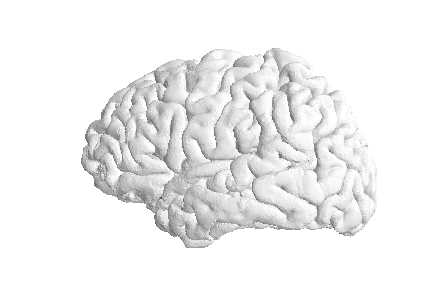

In [138]:
plotting.plot_surf((pial_verts, pial_faces), bg_map=lh_sulcus);

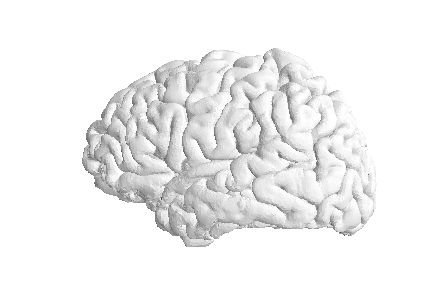

In [146]:
fs_surf_dir = "../local_data/AOMIC/derivatives/freesurfer/sub-0001/surf"
psurf = os.path.join(fs_surf_dir, "lh.pial")
plotting.plot_surf(psurf);

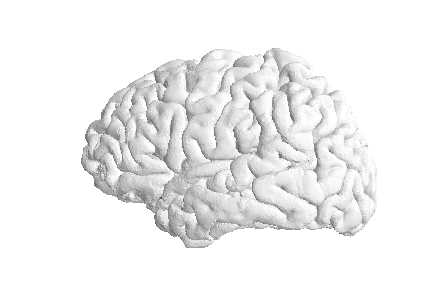

In [139]:
plotting.plot_surf((pial_verts, pial_faces));

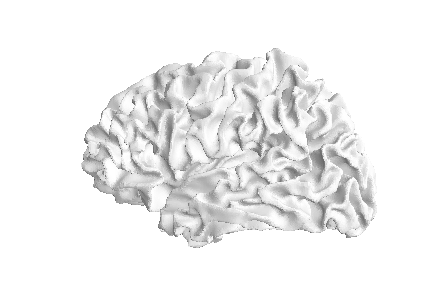

In [48]:
plotting.plot_surf((wm_verts, wm_faces));

In [148]:
plotting.view_surf(psurf, black_bg=True)

In [43]:
plotting.view_surf((wm_verts, wm_faces), black_bg=True)

## Segmenting tissue classes into sub-components (atlasing, parcellation) and visualizing the results

### Visualizing atlases

In [56]:
t1_mni_file = bids_layout.get(subject="0001", scope="derivatives", 
                              datatype='anat', desc='preproc',
                              space='MNI152NLin2009cAsym', 
                              extension='nii.gz', 
                              return_type='filename')[0]

In [57]:
t1_mni = nib.load(t1_mni_file)

In [98]:
atlas_dir = os.path.join(nilearn_cache_dir, 'atlases')

#### 3D atlas: example of AAL

In [59]:
from nilearn.datasets import fetch_atlas_aal

In [60]:
AAL_dataset = fetch_atlas_aal(data_dir=atlas_dir)
AAL_maps = AAL_dataset.maps
AAL_labels = AAL_dataset['labels']
AAL_labels_ix = AAL_dataset['indices']


Dataset created in ../local_data/nilearn_cache/atlases/aal_SPM12



Downloaded 201038 of ? bytes. ...done. (3 seconds, 0 min)
Extracting data from ../local_data/nilearn_cache/atlases/aal_SPM12/9845813e2300e5b614a9dd2713e13445/aal_for_SPM12.tar.gz..... done.


##### Check atlas dimension

In [61]:
AAL_img = nib.load(AAL_maps)

In [62]:
AAL_img.shape

(91, 109, 91)

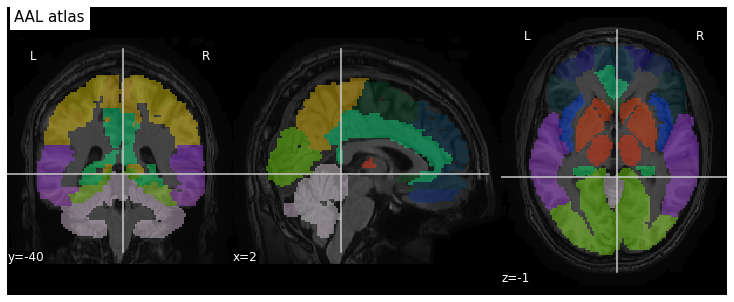

In [100]:
fig = plt.figure(figsize=(10, 4))
plotting.plot_roi(roi_img=AAL_maps, bg_img=t1_mni, alpha=0.4, title="AAL atlas", figure=fig);

##### Extract an ROI

In [66]:
AAL_labels

['Precentral_L',
 'Precentral_R',
 'Frontal_Sup_L',
 'Frontal_Sup_R',
 'Frontal_Sup_Orb_L',
 'Frontal_Sup_Orb_R',
 'Frontal_Mid_L',
 'Frontal_Mid_R',
 'Frontal_Mid_Orb_L',
 'Frontal_Mid_Orb_R',
 'Frontal_Inf_Oper_L',
 'Frontal_Inf_Oper_R',
 'Frontal_Inf_Tri_L',
 'Frontal_Inf_Tri_R',
 'Frontal_Inf_Orb_L',
 'Frontal_Inf_Orb_R',
 'Rolandic_Oper_L',
 'Rolandic_Oper_R',
 'Supp_Motor_Area_L',
 'Supp_Motor_Area_R',
 'Olfactory_L',
 'Olfactory_R',
 'Frontal_Sup_Medial_L',
 'Frontal_Sup_Medial_R',
 'Frontal_Med_Orb_L',
 'Frontal_Med_Orb_R',
 'Rectus_L',
 'Rectus_R',
 'Insula_L',
 'Insula_R',
 'Cingulum_Ant_L',
 'Cingulum_Ant_R',
 'Cingulum_Mid_L',
 'Cingulum_Mid_R',
 'Cingulum_Post_L',
 'Cingulum_Post_R',
 'Hippocampus_L',
 'Hippocampus_R',
 'ParaHippocampal_L',
 'ParaHippocampal_R',
 'Amygdala_L',
 'Amygdala_R',
 'Calcarine_L',
 'Calcarine_R',
 'Cuneus_L',
 'Cuneus_R',
 'Lingual_L',
 'Lingual_R',
 'Occipital_Sup_L',
 'Occipital_Sup_R',
 'Occipital_Mid_L',
 'Occipital_Mid_R',
 'Occipital_Inf_L'

In [102]:
roi_label = "Supp_Motor_Area_L"
roi_label_pos = AAL_labels.index(roi_label)
roi_ix = int(AAL_labels_ix[roi_label_pos])

In [103]:
roi_ix

2401

In [104]:
roi_mask_arr = (AAL_img.get_fdata() == roi_ix)

In [105]:
roi_mask_int = nib.Nifti1Image(roi_mask_arr.astype(int), affine=AAL_img.affine)

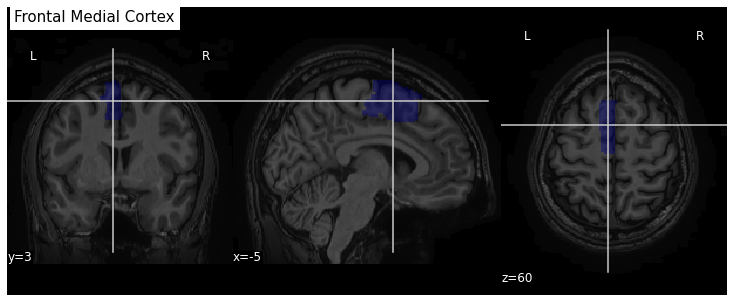

In [125]:
fig = plt.figure(figsize=(10, 4))
plotting.plot_roi(roi_img=roi_mask_int, bg_img=t1_mni, alpha=0.4, title=roi_label, figure=fig);

#### 4D probabilistic atlas: example of Harvard Oxford atlas

In [107]:
from nilearn import image

In [108]:
from nilearn.datasets import fetch_atlas_harvard_oxford

In [109]:
harvard_oxford = fetch_atlas_harvard_oxford('cort-prob-2mm', data_dir=atlas_dir)

In [113]:
harvard_oxford_maps = harvard_oxford['maps']
harvard_oxford_labels = harvard_oxford['labels']

In [114]:
harvard_oxford_img = nib.load(harvard_oxford_maps)

#### Check atlas dimensions

In [115]:
harvard_oxford_img.shape

(91, 109, 91, 48)

In [116]:
harvard_oxford_labels

['Background',
 'Frontal Pole',
 'Insular Cortex',
 'Superior Frontal Gyrus',
 'Middle Frontal Gyrus',
 'Inferior Frontal Gyrus, pars triangularis',
 'Inferior Frontal Gyrus, pars opercularis',
 'Precentral Gyrus',
 'Temporal Pole',
 'Superior Temporal Gyrus, anterior division',
 'Superior Temporal Gyrus, posterior division',
 'Middle Temporal Gyrus, anterior division',
 'Middle Temporal Gyrus, posterior division',
 'Middle Temporal Gyrus, temporooccipital part',
 'Inferior Temporal Gyrus, anterior division',
 'Inferior Temporal Gyrus, posterior division',
 'Inferior Temporal Gyrus, temporooccipital part',
 'Postcentral Gyrus',
 'Superior Parietal Lobule',
 'Supramarginal Gyrus, anterior division',
 'Supramarginal Gyrus, posterior division',
 'Angular Gyrus',
 'Lateral Occipital Cortex, superior division',
 'Lateral Occipital Cortex, inferior division',
 'Intracalcarine Cortex',
 'Frontal Medial Cortex',
 'Juxtapositional Lobule Cortex (formerly Supplementary Motor Cortex)',
 'Subcallo

In [117]:
roi_label = "Frontal Medial Cortex"
# Label indices directly starts from 0 in this case
roi_ix = int(harvard_oxford_labels.index(roi_label))

In [118]:
roi_ix

25

In [119]:
roi_prob_mask = image.index_img(harvard_oxford_maps, roi_ix)

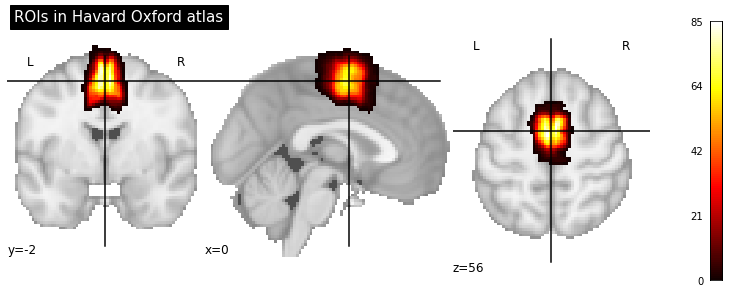

In [126]:
fig = plt.figure(figsize=(10, 4))
plotting.plot_stat_map(roi_prob_mask, title="ROIs in Havard Oxford atlas", figure=fig);

Let's convert the probabilistic mask into a binary mask by fixing a probability threshold

In [121]:
prob_mask_arr = roi_prob_mask.get_fdata()
roi_mask_arr_thr = prob_mask_arr.copy()
thr = 25
roi_mask_arr_thr[roi_mask_arr_thr<thr] = 0
roi_mask_arr_thr[roi_mask_arr_thr>=thr] = 1

In [122]:
roi_mask_thr = nib.Nifti1Image(roi_mask_arr_thr, 
                               affine=roi_prob_mask.affine)

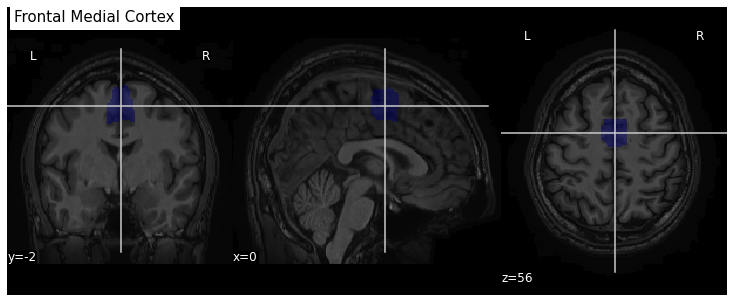

In [127]:
fig = plt.figure(figsize=(10, 4))
plotting.plot_roi(roi_img=roi_mask_thr, bg_img=t1_mni, alpha=0.4, title=roi_label, figure=fig);

#### Note that you can obtain the maps already thresholded


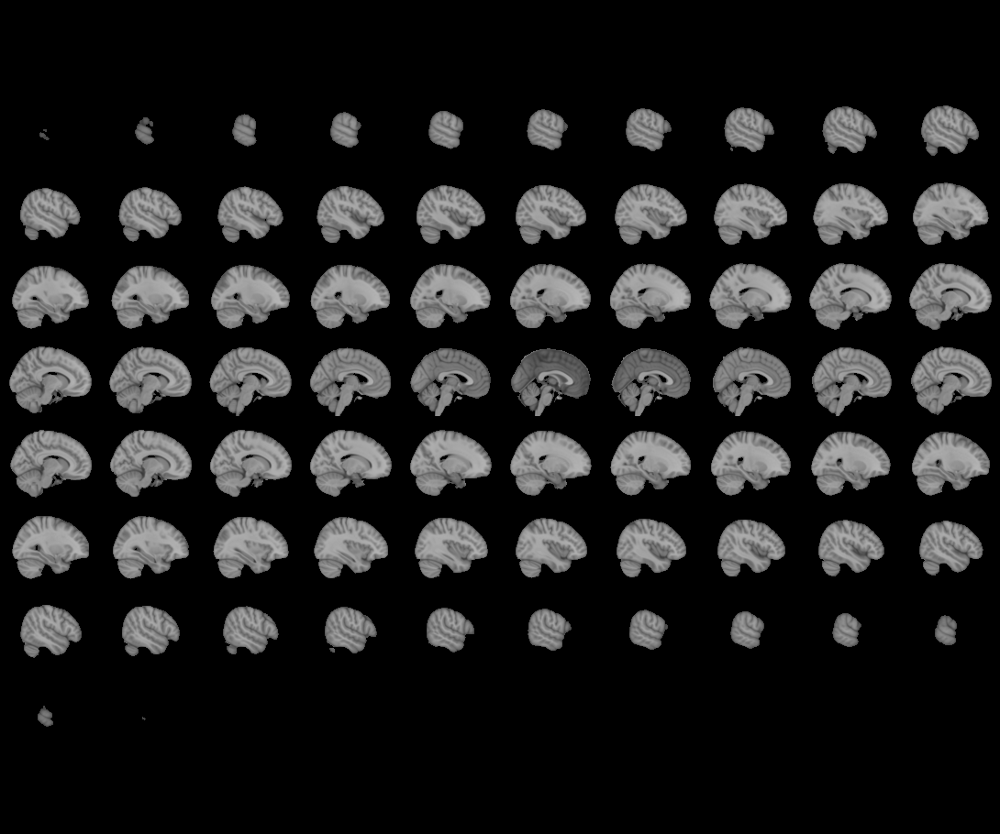
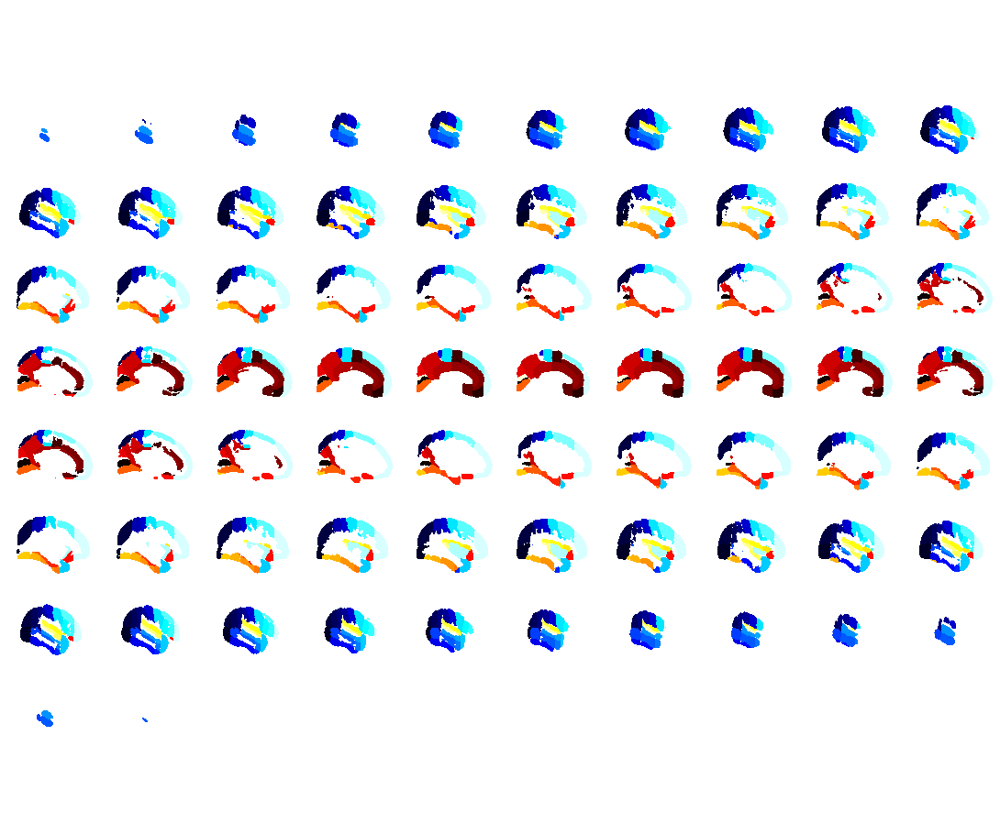

In [124]:
haox_thresholded = fetch_atlas_harvard_oxford('cort-maxprob-thr25-2mm', data_dir=atlas_dir)
haox_thresholded_maps = haox_thresholded['maps']
haox_thresholded_labels = haox_thresholded['labels']
plotting.view_img(haox_thresholded_maps, title="Harvard Oxford atlas", 
                  symmetric_cmap=False, opacity=0.4)

The Harvard-Oxford atlas comes in two sets with `nilearn`, with the other set for subcortical structures.


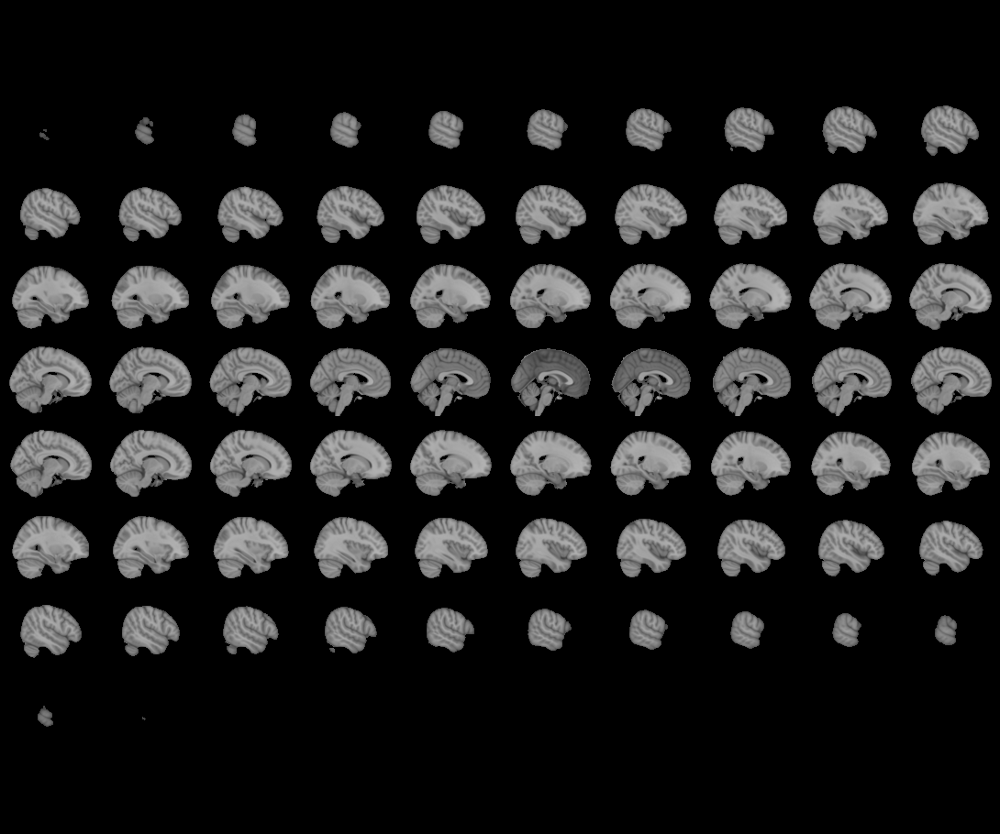
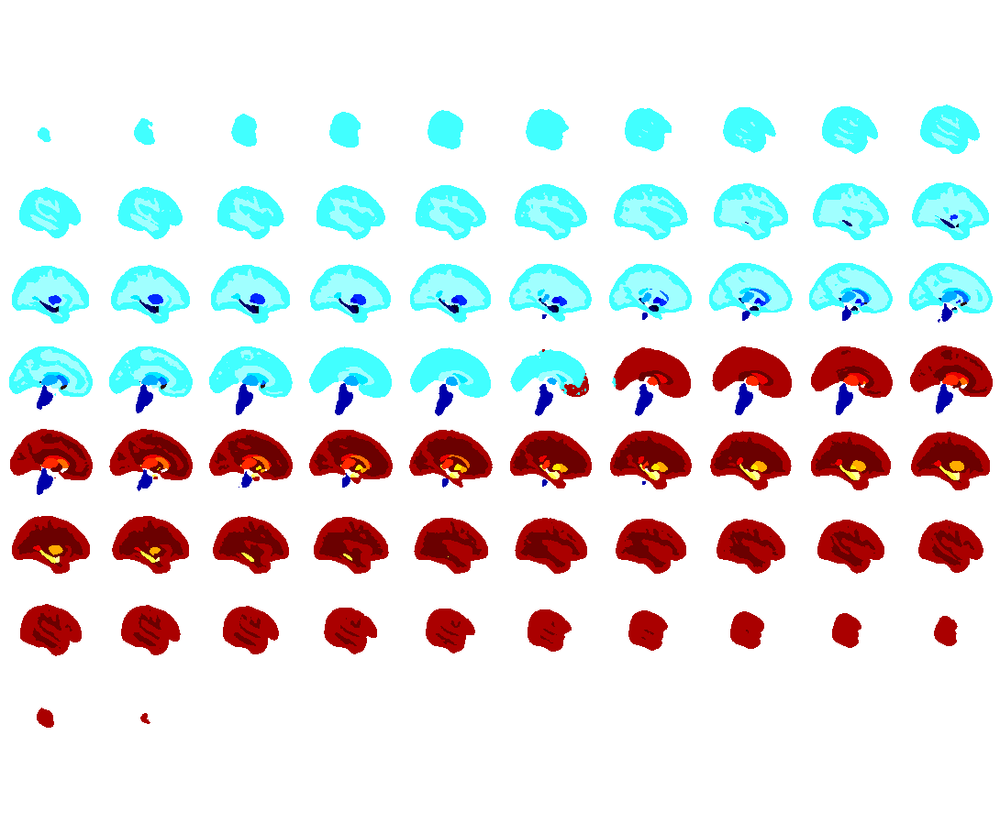

In [128]:
haox_subcortical = fetch_atlas_harvard_oxford('sub-maxprob-thr25-2mm',
                                              data_dir=atlas_dir)
haox_subcortical_maps = haox_subcortical['maps']
haox_subcortical_labels = haox_subcortical['labels']
plotting.view_img(haox_subcortical_maps, title="Harvard Oxford atlas", 
                  symmetric_cmap=False, opacity=0.4)

#### Freesurfer atlas

In [129]:
from nilearn.datasets import fetch_atlas_surf_destrieux
from nilearn.datasets import fetch_surf_fsaverage

In [130]:
# Destrieux parcellation for left hemisphere in fsaverage5 space
destrieux = fetch_atlas_surf_destrieux()
parcellation_L = destrieux['map_left']
parcellation_R = destrieux['map_right']
destrieux_labels = destrieux['labels']

In [131]:
destrieux_labels

[b'Unknown',
 b'G_and_S_frontomargin',
 b'G_and_S_occipital_inf',
 b'G_and_S_paracentral',
 b'G_and_S_subcentral',
 b'G_and_S_transv_frontopol',
 b'G_and_S_cingul-Ant',
 b'G_and_S_cingul-Mid-Ant',
 b'G_and_S_cingul-Mid-Post',
 b'G_cingul-Post-dorsal',
 b'G_cingul-Post-ventral',
 b'G_cuneus',
 b'G_front_inf-Opercular',
 b'G_front_inf-Orbital',
 b'G_front_inf-Triangul',
 b'G_front_middle',
 b'G_front_sup',
 b'G_Ins_lg_and_S_cent_ins',
 b'G_insular_short',
 b'G_occipital_middle',
 b'G_occipital_sup',
 b'G_oc-temp_lat-fusifor',
 b'G_oc-temp_med-Lingual',
 b'G_oc-temp_med-Parahip',
 b'G_orbital',
 b'G_pariet_inf-Angular',
 b'G_pariet_inf-Supramar',
 b'G_parietal_sup',
 b'G_postcentral',
 b'G_precentral',
 b'G_precuneus',
 b'G_rectus',
 b'G_subcallosal',
 b'G_temp_sup-G_T_transv',
 b'G_temp_sup-Lateral',
 b'G_temp_sup-Plan_polar',
 b'G_temp_sup-Plan_tempo',
 b'G_temporal_inf',
 b'G_temporal_middle',
 b'Lat_Fis-ant-Horizont',
 b'Lat_Fis-ant-Vertical',
 b'Lat_Fis-post',
 b'Medial_wall',
 b'Pol

In [132]:
# Plot the Destrieux atlas

Get the mesh on which to plot the label, which will be the pial mesh of the left hemisphere for us.

In [133]:
fsaverage = fetch_surf_fsaverage()
mesh = fsaverage['pial_left']

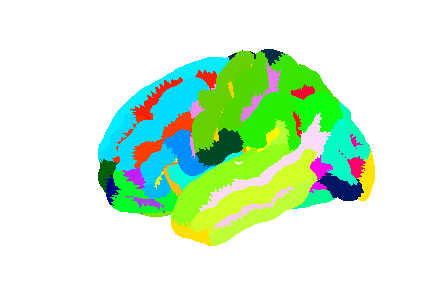

In [134]:
plotting.plot_surf_roi(mesh, roi_map=parcellation_L,
                       hemi='left', view='lateral');

#### Plot a given ROI

In [135]:
# Create ROI array
pcc_region = b'G_cingul-Post-dorsal'
roi_ix = destrieux_labels.index(pcc_region)
roi_mask_arr = (parcellation_L == roi_ix).astype(int)

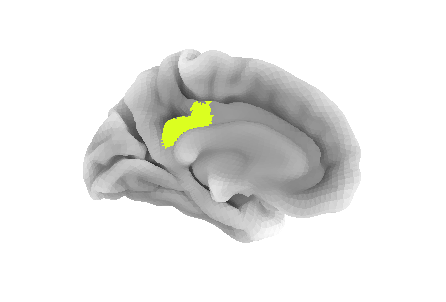

In [136]:
# Plot ROI, 
# using a background image since not all vertices have  label
plotting.plot_surf_roi(mesh, roi_map=roi_mask_arr,
                       hemi='left', view='medial',
                       bg_map=fsaverage['sulc_left']);

# Quantifying tissue properties

## Metric from volumetric data: region volumes

Let's measure the volume of the right caudate region of our subject, from the subcortical segmentation obtained from Freesurfer.

In [119]:
t1_aseg_file = bids_layout.get(subject="1", scope="derivatives", 
                               datatype='anat', suffix='dseg',
                               desc="aseg", extension='nii.gz', return_type='filename')[0]

In [122]:
t1_aseg = nib.load(t1_aseg_file)
t1_aseg_data = t1_aseg.get_fdata()

In [123]:
t1_aseg_data.shape

(124, 256, 256)

According to the Freesurfer legend (link), the ROI of interest has intensity 50.

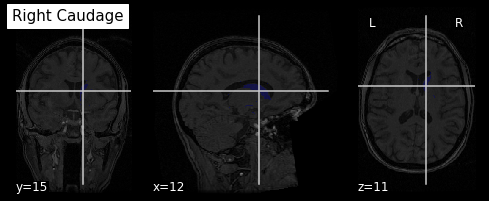

In [127]:
roi_ix = 50
roi_mask_arr = (t1_aseg_data == roi_ix)
roi_mask_int = nib.Nifti1Image(roi_mask_arr.astype(int), 
                               affine=t1_aseg.affine)
plotting.plot_roi(roi_img=roi_mask_int, bg_img=t1, 
                  alpha=0.4, title='Right Caudage');

We can get the number of voxels by counting them in the mask:

In [142]:
caudate_R_n_vox = roi_mask_arr.sum()
caudate_R_n_vox

3048

However we have to take into account voxel sizes in standard unit:

In [134]:
t1.affine

array([[   1.20000005,    0.        ,    0.        ,  -73.80000305],
       [   0.        ,    0.9375    ,    0.        , -119.53125   ],
       [   0.        ,    0.        ,    0.9375    , -119.53125   ],
       [   0.        ,    0.        ,    0.        ,    1.        ]])

In [141]:
vox_size = t1.affine.diagonal().prod()

The volume of interest in mm3 is then:

In [144]:
caudate_R_vol_mm3 = caudate_R_n_vox * vox_size
caudate_R_vol_mm3

3214.6876277402043

### Freesurfer stats

In [107]:
data_dir

'../data'

In [4]:
!ls

aio.md	  CODE_OF_CONDUCT.md  _extras	    _includes	  README.md
AUTHORS   _config.yml	      fig	    index.md	  reference.md
bin	  CONTRIBUTING.md     files	    iquant.ipynb  setup.md
CITATION  _episodes	      Gemfile	    LICENSE.md	  _site
code	  _episodes_rmd       Gemfile.lock  Makefile


In [109]:
freesurfer_dir = os.path.join(sub_dir, 'derivatives', 
                              'sourcedata', 'freesurfer')
sub_fs_stats_dir = os.path.join(freesurfer_dir, 'sub-1', 'stats')

In [111]:
os.listdir(sub_fs_stats_dir)

['lh.BA_exvivo.thresh.stats',
 'rh.aparc.a2009s.stats',
 'rh.aparc.pial.stats',
 'rh.aparc.DKTatlas.stats',
 'lh.curv.stats',
 'lh.w-g.pct.stats',
 'wmparc.stats',
 'lh.aparc.stats',
 'rh.BA_exvivo.thresh.stats',
 'rh.BA_exvivo.stats',
 'rh.w-g.pct.stats',
 'lh.aparc.pial.stats',
 'lh.BA_exvivo.stats',
 'rh.curv.stats',
 'aseg.stats',
 'lh.aparc.DKTatlas.stats',
 'lh.aparc.a2009s.stats',
 'rh.aparc.stats']

### VBM

In [1]:
!pwd

/mnt/linux_data/projects/teaching/carpentry/smri/SDC-BIDS-sMRI/code


In [2]:
vbm_dir = '/mnt/linux_data/projects/teaching/carpentry/smri/data_VBM'

In [9]:
sub_info_csv = os.path.join(vbm_dir, 'sub_info.csv')

In [10]:
sub_info_df = pd.read_csv(sub_info_csv)

In [54]:
sub_info_df[350:400]

,Sub_ID,Sex,Age,Sex.1,Edinburgh Handedness Inventory (EHI),FunImg,T1Img
350,31624,F,23,1,NaN,1,1
351,31625,F,48,1,NaN,1,1
352,31626,F,26,1,NaN,1,1
353,31627,F,47,1,NaN,1,1
354,31628,F,22,1,NaN,1,1
355,31629,F,21,1,NaN,1,1
356,31630,F,23,1,NaN,1,1
357,31631,F,24,1,NaN,1,1
358,31632,F,24,1,NaN,1,1
359,31633,F,54,1,NaN,1,1


In [52]:
subset1 = sub_info_df.iloc[350:400]['Age']

(18.0, 80.0)

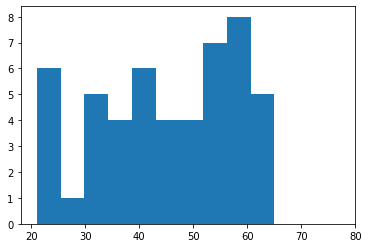

In [53]:
plt.hist(subset1)
plt.xlim(18, 80)